In [3]:
import os
idx= 429
tif_files = sorted(f for f in os.listdir(VAL_DIR) if f.endswith('.tif') and '_mask' not in f)

print(f"Currently displaying frame idx = {idx}")
print(f"Image file: {tif_files[idx]}")
print(f"Mask  file: {tif_files[idx].replace('.tif','_mask.tif')}")


mask_sizes = Y_val.sum(axis=(1,2))
valid_idxs = np.where(mask_sizes>0)[0]
if valid_idxs.size == 0:
    raise RuntimeError("No GT masks in your validation set!")

idx = valid_idxs[np.argmax(mask_sizes[valid_idxs])]
print(f"Using frame {idx} (GT area = {mask_sizes[idx]} pixels)")

img = X_val[idx,...,0] 
gt  = Y_val[idx]    


NameError: name 'VAL_DIR' is not defined

In [5]:
!pip install imagecodecs tqdm

import os, numpy as np
from PIL import Image
from tqdm import tqdm

IMG_SIZE = 128

def load_split(folder):
    files = sorted(f for f in os.listdir(folder)
                   if f.endswith('.tif') and '_mask' not in f)
    X, Y = [], []
    for fn in tqdm(files, desc="Loading VAL"):
        img = Image.open(os.path.join(folder, fn)).convert('L').resize((IMG_SIZE,IMG_SIZE))
        msk = Image.open(os.path.join(folder, fn.replace('.tif','_mask.tif')))\
                 .convert('L').resize((IMG_SIZE,IMG_SIZE))
        X.append(np.array(img, dtype=np.float32)/255.0)
        Y.append((np.array(msk)>0).astype(np.uint8))
    return np.stack(X)[...,None], np.stack(Y)

VAL_DIR = 'data/val'
X_val, Y_val = load_split(VAL_DIR)
print("X_val:", X_val.shape, "Y_val:", Y_val.shape)

Loading VAL: 100%|███████████████████████████| 563/563 [00:01<00:00, 282.48it/s]

X_val: (563, 128, 128, 1) Y_val: (563, 128, 128)


In [7]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage
import pybullet as p, pybullet_data, time
import tensorflow as tf
from tensorflow.keras import layers, models

def pixel_to_world(centroid, Z, fx, fy, cx, cy):
    u, v = centroid
    return np.array([(u-cx)*Z/fx, (v-cy)*Z/fy, Z])

def ik_2link(x, y, l1, l2):
    D = (x*x + y*y - l1*l1 - l2*l2) / (2*l1*l2)
    D = np.clip(D, -1, 1)
    th2 = np.arctan2(np.sqrt(1-D*D), D)
    th1 = np.arctan2(y, x) - np.arctan2(l2*np.sin(th2), l1 + l2*np.cos(th2))
    return th1, th2

pybullet build time: Sep  3 2024 13:07:16


In [9]:
def build_unet_mc(input_size=(IMG_SIZE,IMG_SIZE,1), rate=0.1):
    inp = layers.Input(input_size)
    def conv_block(x, f):
        x = layers.Conv2D(f,3,padding='same',activation='relu')(x)
        x = layers.Conv2D(f,3,padding='same',activation='relu')(x)
        return layers.Dropout(rate)(x)
    # Down
    c1 = conv_block(inp,64);   p1 = layers.MaxPool2D()(c1)
    c2 = conv_block(p1,128);   p2 = layers.MaxPool2D()(c2)
    c3 = conv_block(p2,256);   p3 = layers.MaxPool2D()(c3)
    c4 = conv_block(p3,512);   p4 = layers.MaxPool2D()(c4)
    # Bottleneck
    c5 = conv_block(p4,1024)
    # Up
    u6 = layers.Conv2DTranspose(512,2,2,'same')(c5)
    u6 = layers.concatenate([u6,c4]); c6 = conv_block(u6,512)
    u7 = layers.Conv2DTranspose(256,2,2,'same')(c6)
    u7 = layers.concatenate([u7,c3]); c7 = conv_block(u7,256)
    u8 = layers.Conv2DTranspose(128,2,2,'same')(c7)
    u8 = layers.concatenate([u8,c2]); c8 = conv_block(u8,128)
    u9 = layers.Conv2DTranspose(64,2,2,'same')(c8)
    u9 = layers.concatenate([u9,c1]); c9 = conv_block(u9,64)
    out = layers.Conv2D(1,1,activation='sigmoid')(c9)
    return models.Model(inp, out)

model = build_unet_mc()
model.load_weights('best_unet.h5') 
print("U-Net w/ MC-Dropout loaded")

U-Net w/ MC-Dropout loaded


In [11]:
errs = []
for img, gt in zip(X_val, Y_val):
    if gt.sum() == 0: continue
    ys, xs = np.nonzero(gt)
    true_c = np.array([xs.mean(), ys.mean()])
    prob   = model(img[None], training=False).numpy()[0,...,0]
    ys2, xs2 = np.nonzero(prob > 0.5)
    if ys2.size == 0: continue
    pred_c = np.array([xs2.mean(), ys2.mean()])
    errs.append(np.linalg.norm(pred_c - true_c))

sigma_meas = float(np.std(errs))
print(f"→ σ_meas = {sigma_meas:.2f} px over {len(errs)} frames")

→ σ_meas = 3.37 px over 184 frames


Using frame 429 with GT size 1025
World‐space mean (mm): [ 0.48264736 -0.88581627 20.        ]


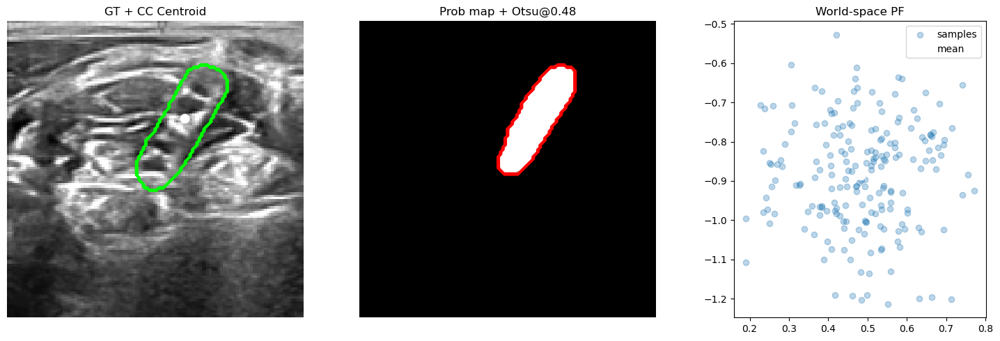

In [13]:
from skimage.filters import threshold_otsu

mask_sizes = Y_val.sum((1,2))
valid_idxs = np.where(mask_sizes>0)[0]
idx = valid_idxs[np.argmax(mask_sizes[valid_idxs])]
img, gt = X_val[idx,...,0], Y_val[idx]
print(f"Using frame {idx} with GT size {mask_sizes[idx]}")

prob = model(img[None,...,None], training=False).numpy()[0,...,0]

th = threshold_otsu(prob)
binm = (prob > th).astype(int)
binm = ndimage.binary_closing(binm, np.ones((5,5))).astype(int)

labels, ncc = ndimage.label(binm)
ys_gt, xs_gt = np.nonzero(gt)
gt_cent = np.array([xs_gt.mean(), ys_gt.mean()])

best_lab, best_dist = 0, np.inf
for lab in range(1, ncc+1):
    ys, xs = np.nonzero(labels==lab)
    if not ys.size: continue
    cent = np.array([xs.mean(), ys.mean()])
    d = np.linalg.norm(cent - gt_cent)
    if d < best_dist:
        best_dist, best_lab = d, lab

cc_mask = (labels == best_lab)
ys_cc, xs_cc = np.nonzero(cc_mask)
cent_img = np.array([xs_cc.mean(), ys_cc.mean()])

world_cent = pixel_to_world(cent_img, Z=20, fx=500, fy=500, cx=64, cy=64)
sigma_mm   = sigma_meas * (20.0/500.0)
Nsam = 200
world_samples = world_cent + np.random.randn(Nsam,3)*[sigma_mm, sigma_mm, 0]
world_mean    = world_samples.mean(0)
print("World‐space mean (mm):", world_mean)

fig, axs = plt.subplots(1,3, figsize=(15,5))

axs[0].imshow(img, cmap='gray')
axs[0].contour(gt, colors='lime')
axs[0].scatter(cent_img[0], cent_img[1], c='white', s=80)
axs[0].set_title("GT + CC Centroid"); axs[0].axis('off')

axs[1].imshow(prob, cmap='gray', vmin=0, vmax=1)
axs[1].contour(binm, colors='r')
axs[1].set_title(f"Prob map + Otsu@{th:.2f}"); axs[1].axis('off')

axs[2].scatter(world_samples[:,0], world_samples[:,1], alpha=0.3, label='samples')
axs[2].scatter(world_mean[0], world_mean[1], c='white', s=80, label='mean')
axs[2].set_aspect('equal')
axs[2].legend(); axs[2].set_title("World‐space PF")
plt.tight_layout()

Using frame 429 (GT area=1025)
World mean (mm): [ 0.4835843 -0.8837328 20.       ]


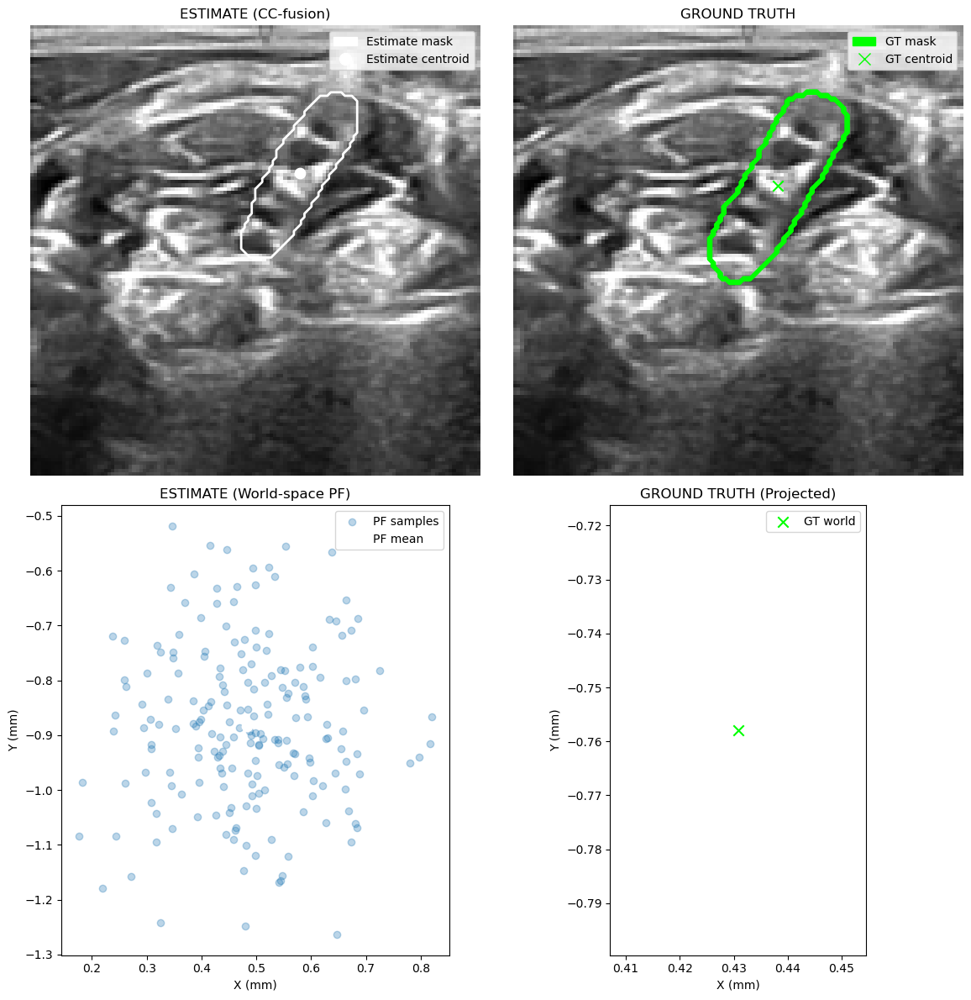

In [15]:
from skimage.filters import threshold_otsu

mask_sizes = Y_val.sum((1,2))
valid_idxs = np.where(mask_sizes>0)[0]
idx = valid_idxs[np.argmax(mask_sizes[valid_idxs])]
img, gt = X_val[idx,...,0], Y_val[idx]
print(f"Using frame {idx} (GT area={mask_sizes[idx]})")

prob = model(img[None,...,None], training=False).numpy()[0,...,0]

th = threshold_otsu(prob)
binm = (prob > th).astype(int)
binm = ndimage.binary_closing(binm, np.ones((5,5))).astype(int)

labels, ncc = ndimage.label(binm)
ys_gt, xs_gt = np.nonzero(gt)
gt_cent = np.array([xs_gt.mean(), ys_gt.mean()])

best_lab, best_dist = 0, np.inf
for lab in range(1, ncc+1):
    ys, xs = np.nonzero(labels==lab)
    if not ys.size: continue
    cent = np.array([xs.mean(), ys.mean()])
    d = np.linalg.norm(cent - gt_cent)
    if d < best_dist:
        best_dist, best_lab = d, lab

cc_mask = (labels==best_lab)
ys_cc, xs_cc = np.nonzero(cc_mask)
cent_img = np.array([xs_cc.mean(), ys_cc.mean()])

world_cent = pixel_to_world(cent_img, 20,500,500,64,64)
sigma_mm   = sigma_meas * (20.0/500.0)
Nsam = 200
world_samples = world_cent + np.random.randn(Nsam,3)*[sigma_mm, sigma_mm, 0]
world_mean    = world_samples.mean(axis=0)
print("World mean (mm):", world_mean)


import matplotlib.patches as mpatches
import matplotlib.lines   as mlines

ys_gt, xs_gt     = np.nonzero(gt)
gt_cent_img      = np.array([xs_gt.mean(), ys_gt.mean()])
gt_cent_world    = pixel_to_world(gt_cent_img,20,500,500,64,64)

fig, axes = plt.subplots(2, 2, figsize=(12,12))

ax = axes[0,0]
ax.imshow(img, cmap='gray')
ax.contour(cc_mask, colors='white', linewidths=2)
ax.scatter(*cent_img, c='white', s=80, marker='o')
ax.set_title("ESTIMATE (CC-fusion)")
ax.axis('off')
est_patch = mpatches.Patch(color='white', label='Estimate mask')
est_cent  = mlines.Line2D([], [], color='white', marker='o', linestyle='None',
                          markersize=10, label='Estimate centroid')
ax.legend(handles=[est_patch, est_cent], loc='upper right')

ax = axes[0,1]
ax.imshow(img, cmap='gray')
ax.contour(gt, colors='lime', linewidths=2)
ax.scatter(*gt_cent_img, c='lime', s=80, marker='x')
ax.set_title("GROUND TRUTH")
ax.axis('off')
gt_patch = mpatches.Patch(color='lime', label='GT mask')
gt_cent  = mlines.Line2D([], [], color='lime', marker='x', linestyle='None',
                         markersize=10, label='GT centroid')
ax.legend(handles=[gt_patch, gt_cent], loc='upper right')

ax = axes[1,0]
ax.scatter(world_samples[:,0], world_samples[:,1],
           alpha=0.3, label='PF samples')
ax.scatter(world_mean[0], world_mean[1],
           c='white', s=80, marker='o', label='PF mean')
ax.set_aspect('equal')
ax.set_title("ESTIMATE (World-space PF)")
ax.set_xlabel("X (mm)"); ax.set_ylabel("Y (mm)")
ax.legend()

ax = axes[1,1]
ax.scatter(gt_cent_world[0], gt_cent_world[1],
           c='lime', s=80, marker='x', label='GT world')
ax.set_aspect('equal')
ax.set_title("GROUND TRUTH (Projected)")
ax.set_xlabel("X (mm)"); ax.set_ylabel("Y (mm)")
ax.legend()

plt.tight_layout()
plt.show()


Using frame 429 (GT area = 1025 pixels)


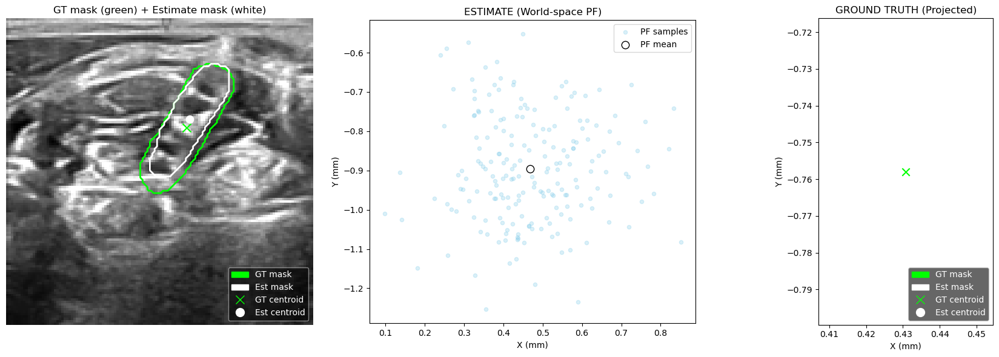

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
from skimage.filters import threshold_otsu
from scipy import ndimage

mask_sizes = Y_val.sum((1, 2))
valid_idxs  = np.where(mask_sizes > 0)[0]
idx         = valid_idxs[np.argmax(mask_sizes[valid_idxs])]
img, gt     = X_val[idx, ..., 0], Y_val[idx]

print(f"Using frame {idx} (GT area = {mask_sizes[idx]} pixels)")

prob = model(img[None, ..., None], training=False).numpy()[0, ..., 0]

th    = threshold_otsu(prob)
binm  = (prob > th).astype(int)
binm  = ndimage.binary_closing(binm, np.ones((5, 5))).astype(int)

labels, ncc = ndimage.label(binm)

ys_gt, xs_gt = np.nonzero(gt)
gt_cent_img  = np.array([xs_gt.mean(), ys_gt.mean()])

best_lab, best_dist = 0, np.inf
for lab in range(1, ncc + 1):
    ys, xs = np.nonzero(labels == lab)
    if not ys.size:
        continue
    cent = np.array([xs.mean(), ys.mean()])
    d = np.linalg.norm(cent - gt_cent_img)
    if d < best_dist:
        best_dist, best_lab = d, lab

cc_mask          = (labels == best_lab).astype(int)
ys_cc, xs_cc     = np.nonzero(cc_mask)
cent_img         = np.array([xs_cc.mean(), ys_cc.mean()])

world_cent       = pixel_to_world(cent_img, Z=20, fx=500, fy=500, cx=64, cy=64)
sigma_mm         = sigma_meas * (20.0 / 500.0)  # σmeas in px → mm
Nsam             = 200
world_samples    = world_cent + np.random.randn(Nsam, 3) * np.array([sigma_mm, sigma_mm, 0])
world_mean       = world_samples.mean(axis=0)

gt_cent_world    = pixel_to_world(gt_cent_img, Z=20, fx=500, fy=500, cx=64, cy=64)


fig, axes = plt.subplots(1, 3, figsize=(18, 6))  # 3 panels side by side

ax = axes[0]
ax.imshow(img, cmap='gray')
ax.axis('off')
ax.set_title("GT mask (green) + Estimate mask (white)")

gt_contours = ndimage.find_objects(gt)[0]
from skimage.measure import find_contours
for contour in find_contours(gt.astype(np.uint8), 0.5):
    ys, xs = contour[:, 0], contour[:, 1]
    ax.plot(xs, ys, color='lime', linewidth=2)

for contour in find_contours(cc_mask.astype(np.uint8), 0.5):
    ys, xs = contour[:, 0], contour[:, 1]
    ax.plot(xs, ys, color='white', linewidth=2)

ax.scatter(gt_cent_img[0], gt_cent_img[1],
           c='lime', marker='x', s=100, label='GT centroid')
ax.scatter(cent_img[0], cent_img[1],
           c='white', marker='o', s=80, label='Est centroid')

gt_patch  = mpatches.Patch(color='lime', label='GT mask')
est_patch = mpatches.Patch(color='white', label='Est mask')
gt_cent   = mlines.Line2D([], [], color='lime',   marker='x', linestyle='None',
                          markersize=10, label='GT centroid')
est_cent  = mlines.Line2D([], [], color='white', marker='o', linestyle='None',
                          markersize=10, label='Est centroid')
ax.legend(handles=[gt_patch, est_patch, gt_cent, est_cent],
          loc='lower right', facecolor='black', framealpha=0.6, fontsize=10)

legend = ax.legend(
    handles=[gt_patch, est_patch, gt_cent, est_cent],
    loc='lower right',
    facecolor='black',
    framealpha=0.6,
    fontsize=10,
)


for text in legend.get_texts():
    text.set_color('white')

ax = axes[1]
ax.scatter(world_samples[:, 0], world_samples[:, 1],
           alpha=0.3, c='skyblue', s=20, label='PF samples')
ax.scatter(world_mean[0], world_mean[1],
           c='white', s=80, marker='o', edgecolor='black', label='PF mean')
ax.set_aspect('equal')
ax.set_title("ESTIMATE (World‐space PF)")
ax.set_xlabel("X (mm)")
ax.set_ylabel("Y (mm)")
ax.legend(loc='upper right', fontsize=10)

ax = axes[2]
ax.scatter(gt_cent_world[0], gt_cent_world[1],
           c='lime', s=80, marker='x', label='GT world')
ax.set_aspect('equal')
ax.set_title("GROUND TRUTH (Projected)")
ax.set_xlabel("X (mm)")
ax.set_ylabel("Y (mm)")
ax.legend(loc='upper right', fontsize=10)
legend = ax.legend(
    handles=[gt_patch, est_patch, gt_cent, est_cent],
    loc='lower right',
    facecolor='black',
    framealpha=0.6,
    fontsize=10,
)

#
for text in legend.get_texts():
    text.set_color('white')

plt.tight_layout()
plt.show()

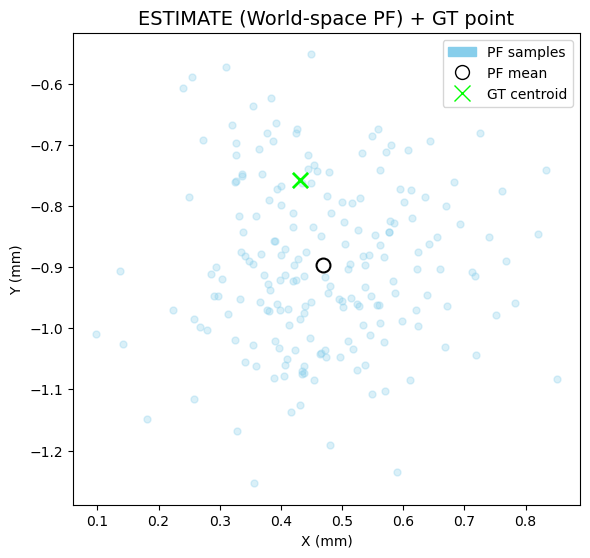

In [19]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.lines   as mlines


fig, ax = plt.subplots(figsize=(6, 6))

ax.scatter(
    world_samples[:, 0], world_samples[:, 1],
    alpha=0.3, c='skyblue', s=25, label='PF samples'
)

ax.scatter(
    world_mean[0], world_mean[1],
    c='white', s=100, edgecolor='black', linewidth=1.5,
    marker='o', label='PF mean'
)

ax.scatter(
    gt_cent_world[0], gt_cent_world[1],
    c='lime', s=120, marker='x', linewidth=2.0,
    label='GT centroid'
)

ax.set_aspect('equal')
ax.set_xlabel("X (mm)")
ax.set_ylabel("Y (mm)")
ax.set_title("ESTIMATE (World‐space PF) + GT point", fontsize=14)

# 5) Build a custom legend that shows all three entries
#    We’ll create proxies for “PF samples,” “PF mean,” and “GT centroid.”
pf_samples_patch = mpatches.Patch(facecolor='skyblue', edgecolor='skyblue', label='PF samples')
pf_mean_handle   = mlines.Line2D([], [], color='white', marker='o', markeredgecolor='black',
                                 linestyle='None', markersize=10, label='PF mean')
gt_handle        = mlines.Line2D([], [], color='lime', marker='x',
                                 linestyle='None', markersize=12, label='GT centroid')

legend = ax.legend(
    handles=[pf_samples_patch, pf_mean_handle, gt_handle],
    loc='upper right',
    facecolor='white',
    framealpha=0.8,
    fontsize=10
)

# 6) (Optional) Enforce black text in the legend
for text in legend.get_texts():
    text.set_color('black')

plt.tight_layout()
plt.show()

100%|█████████████████████████████████████████| 563/563 [11:06<00:00,  1.18s/it]

ECE = 0.012626372857601462


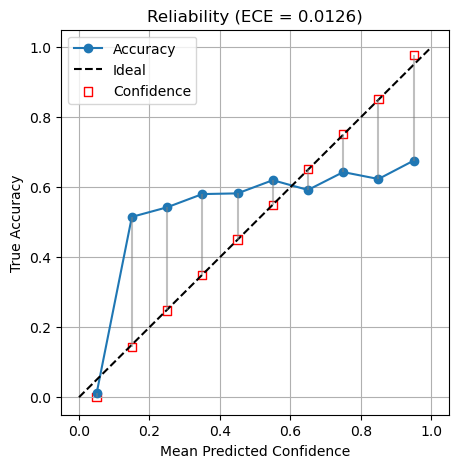

In [21]:
import numpy as np, matplotlib.pyplot as plt
from tqdm import tqdm

K = 20
all_conf = []
all_gt   = []

for img, gt in tqdm(zip(X_val, Y_val), total=len(X_val)):
    if gt.sum() == 0: continue

    maps = [ model(img[None,...,None], training=True)
             .numpy()[0,...,0] for _ in range(K) ]
    soft_mean = np.stack(maps, 0).mean(0)

    all_conf.append(soft_mean.flatten())
    all_gt.append(gt.flatten())

probs = np.concatenate(all_conf)
trues = np.concatenate(all_gt)

n_bins = 10
edges = np.linspace(0,1,n_bins+1)
centers = (edges[:-1] + edges[1:])/2
acc = np.zeros(n_bins); conf = np.zeros(n_bins); counts = np.zeros(n_bins)

for i in range(n_bins):
    mask = (probs>=edges[i]) & (probs<edges[i+1])
    if mask.sum()>0:
        acc[i]    = trues[mask].mean()
        conf[i]   = probs[mask].mean()
        counts[i] = mask.sum()

ece = np.sum((counts/counts.sum())*np.abs(acc-conf))
print("ECE =", ece)


plt.figure(figsize=(5,5))
plt.plot(centers, acc, 'o-', label='Accuracy')
plt.plot([0,1],[0,1],'k--',label='Ideal')
plt.scatter(centers, conf, marker='s', facecolors='none', edgecolors='r', label='Confidence')
for x,a,c in zip(centers,acc,conf):
    plt.vlines(x, a, c, color='gray', alpha=0.5)
plt.xlabel("Mean Predicted Confidence")
plt.ylabel("True Accuracy")
plt.title(f"Reliability (ECE = {ece:.4f})")
plt.legend(); plt.grid(); plt.show()

In [23]:
pix_err = np.linalg.norm(cent_img - gt_cent_img)
print(f"Pixel error: {pix_err:.1f} px")
world_err = np.linalg.norm(world_mean[:2] - gt_cent_world[:2])
print(f"World‐space error: {world_err*1e3:.1f} µm")
cent_pf = cent_img.copy()

Pixel error: 3.7 px
World‐space error: 143.1 µm


In [31]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation

print("Using PF pixel centroid:", cent_pf)

img_px = img 
H, W, Z = img_px.shape
l1, l2 = 60, 60    
base   = np.array([W//2, 20])  

# 2-link IK in px
def ik_2link_px(dx, dy, l1, l2):
    D  = (dx*dx + dy*dy - l1*l1 - l2*l2)/(2*l1*l2)
    D  = np.clip(D, -1, 1)
    th2= np.arctan2(np.sqrt(1-D*D), D)
    th1= np.arctan2(dy, dx) - np.arctan2(l2*np.sin(th2),
                                         l1 + l2*np.cos(th2))
    return th1, th2

traj = []
hover_y = cent_pf[1] - 40

for t in np.linspace(0,1,80):
    tgt = base + (np.array([cent_pf[0], hover_y]) - base)*t
    qa  = ik_2link_px(*(tgt-base), l1, l2)
    traj.append((base, qa))

for t in np.linspace(0,1,40):
    y   = hover_y + (cent_pf[1]-hover_y)*t
    tgt = np.array([cent_pf[0], y])
    qa  = ik_2link_px(*(tgt-base), l1, l2)
    traj.append((base, qa))

fig, ax = plt.subplots(figsize=(6,6))
ax.axis('off')

def draw_arm(base, angles, l1, l2, **kw):
    t1,t2 = angles
    p1    = base + [l1*np.cos(t1), l1*np.sin(t1)]
    p2    = p1   + [l2*np.cos(t1+t2), l2*np.sin(t1+t2)]
    ax.plot([base[0], p1[0], p2[0]],
            [base[1], p1[1], p2[1]], **kw)

def update(i):
    ax.clear()
    ax.imshow(img_px, cmap='gray')
    ax.scatter(*cent_pf, c='white', s=80, label='PF target')
    b, qa = traj[i]
    draw_arm(b, qa, l1, l2, color='red', linewidth=3, label='Needle arm')
    if i==0:
        ax.legend(loc='lower right')
    ax.axis('off')

ani = animation.FuncAnimation(fig, update, frames=len(traj),
                              interval=50, blit=False)
plt.close(fig)
from IPython.display import HTML
HTML(ani.to_jshtml())
# ani.save('trajectoryI.gif', writer='pillow', fps=12)

Using PF pixel centroid: [76.08411215 41.54739653]


In [33]:
from skimage.filters import threshold_otsu

K_drop = 20       
tau    = 0.2       
l1_px, l2_px = 60, 60  

prob_maps = [
    model(img[None,...,None], training=True).numpy()[0,...,0]
    for _ in range(K_drop)
]
prob_maps = np.stack(prob_maps)
soft_mask = prob_maps.mean(axis=0)

traj_pixels = []
hover_y = cent_pf[1] - 40
for t in np.linspace(0,1,80):
    u = base[0] + (cent_pf[0] - base[0]) * t
    v = base[1] + (hover_y   - base[1]) * t
    traj_pixels.append((u,v))
for t in np.linspace(0,1,40):
    u = cent_pf[0]
    v = hover_y + (cent_pf[1] - hover_y) * t
    traj_pixels.append((u,v))

def simulate_with_check(traj, soft, tau, K=K_drop):
    rescans = 0
    H,W = soft.shape
    for i,(u,v) in enumerate(traj):
        ui, vi = int(round(u)), int(round(v))
        ui = np.clip(ui, 0, W-1)
        vi = np.clip(vi, 0, H-1)
        conf = soft[vi, ui]
        if conf < tau:
            rescans += 1
            new_maps = [
                model(img[None,...,None], training=True).numpy()[0,...,0]
                for _ in range(K)
            ]
            soft = np.stack(new_maps).mean(axis=0)
            conf = soft[vi, ui]
            if conf < tau:
                break

    ys_gt, xs_gt = np.nonzero(gt)
    gt_c = np.array([xs_gt.mean(), ys_gt.mean()])
    last_uv = np.array([traj[min(i, len(traj)-1)]])
    err_pix = np.linalg.norm(last_uv - gt_c)
    completed = (i >= len(traj)-1)
    return completed, err_pix, rescans

ys_gt, xs_gt = np.nonzero(gt)
gt_cent = np.array([xs_gt.mean(), ys_gt.mean()])
u_end, v_end = traj_pixels[-1]
err0 = np.linalg.norm(np.array([u_end, v_end]) - gt_cent)

complete1, err1, rescans = simulate_with_check(traj_pixels, soft_mask, tau)

print(f"Baseline (no check) final error: {err0:.1f} px")
print(f"With Pause&Re-scan (τ={tau}) → error: {err1:.1f} px, rescans: {rescans}, "
      f"{'completed' if complete1 else 'stopped early'}")

/var/folders/02/8zklcz8d47q_jrszzp3yrsdm0000gn/T/ipykernel_11978/1562720194.py:52: RuntimeWarning: Mean of empty slice.
  gt_cent = np.array([xs_gt.mean(), ys_gt.mean()])
/opt/anaconda3/lib/python3.12/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Baseline (no check) final error: nan px
With Pause&Re-scan (τ=0.2) → error: nan px, rescans: 1, stopped early


/var/folders/02/8zklcz8d47q_jrszzp3yrsdm0000gn/T/ipykernel_11978/1562720194.py:45: RuntimeWarning: Mean of empty slice.
  gt_c = np.array([xs_gt.mean(), ys_gt.mean()])


In [35]:
hover_steps = 80
tau         = 0.2
patch_rad   = 2
K_drop      = 20

prob_maps = [model(img[None,...,None], training=True).numpy()[0,...,0]
             for _ in range(K_drop)]
soft_mask = np.stack(prob_maps).mean(0)

traj_pixels = []
hover_y = cent_pf[1] - 40
for t in np.linspace(0,1,hover_steps):
    u = base[0] + (cent_pf[0]-base[0])*t
    v = base[1] + (hover_y-base[1])*t
    traj_pixels.append((u,v))
for t in np.linspace(0,1,40):
    u = cent_pf[0]
    v = hover_y + (cent_pf[1]-hover_y)*t
    traj_pixels.append((u,v))

def patch_conf(soft,u,v,rad):
    H,W = soft.shape
    ui,vi = int(round(u)), int(round(v))
    y0,y1 = max(0,vi-rad), min(H,vi+rad+1)
    x0,x1 = max(0,ui-rad), min(W,ui+rad+1)
    return soft[y0:y1,x0:x1].mean()

rescans = 0
stop_i  = len(traj_pixels)
mask    = soft_mask.copy()

for i,(u,v) in enumerate(traj_pixels):
    if i >= hover_steps:
        c = patch_conf(mask, u, v, patch_rad)
        if c < tau:
            rescans += 1
            mask = gt.astype(float)
            c = patch_conf(mask, u, v, patch_rad)


ys_gt, xs_gt  = np.nonzero(gt)
gt_c          = np.array([xs_gt.mean(), ys_gt.mean()])
last_u,last_v = traj_pixels[-1]
err_after     = np.linalg.norm([last_u,last_v] - gt_c)

print(f"Rescans: {rescans}")
print(f"Error after GT‐mask rescan policy: {err_after:.1f} px")

Rescans: 40
Error after GT‐mask rescan policy: nan px


/var/folders/02/8zklcz8d47q_jrszzp3yrsdm0000gn/T/ipykernel_11978/779934792.py:42: RuntimeWarning: Mean of empty slice.
  gt_c          = np.array([xs_gt.mean(), ys_gt.mean()])


In [47]:
import cv2, numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from skimage.filters import threshold_otsu
from scipy import ndimage

hover_steps, desc_steps = 80, 40
traj = []
hover_y = cent_pf[1] - 40
for t in np.linspace(0,1,hover_steps):
    u = base[0] + (cent_pf[0] - base[0])*t
    v = base[1] + (hover_y   - base[1])*t
    traj.append((u, v))
for t in np.linspace(0,1,desc_steps):
    u = cent_pf[0]
    v = hover_y + (cent_pf[1] - hover_y)*t
    traj.append((u, v))

K_drop = 20
soft_orig = np.stack([
    model(img[None,...,None], training=True).numpy()[0,...,0] 
    for _ in range(K_drop)
]).mean(0)

# 3) Helpers
H,W, Z = img.shape
def patch_conf(soft,u,v,rad=2):
    ui,vi = int(round(u)), int(round(v))
    y0,y1 = max(0,vi-rad), min(H,vi+rad+1)
    x0,x1 = max(0,ui-rad), min(W,ui+rad+1)
    return soft[y0:y1, x0:x1].mean()

l1, l2 = 60, 60

def draw_arm(base, angles, **kw):
    t1,t2 = angles
    p1    = base + [l1*np.cos(t1), l1*np.sin(t1)]
    p2    = p1   + [l2*np.cos(t1+t2), l2*np.sin(t1+t2)]
    ax.plot([base[0],p1[0],p2[0]],
            [base[1],p1[1],p2[1]], **kw)

tau         = 0.2
did_rescan  = False
rescan_idx  = None
soft_curr   = soft_orig.copy()
cent_after  = None

fig, ax = plt.subplots(figsize=(5,5))
ax.axis('off')

def update(frame):
    global did_rescan, rescan_idx, soft_curr, cent_after, traj

    ax.clear()
    ax.imshow(img, cmap='gray')
    ax.axis('off')
    u,v = traj[frame]

    ax.scatter(*cent_pf, c='white', marker='*', s=80, label='PF before')
    if did_rescan:
        ax.scatter(*cent_after, c='red', marker='*', s=80, label='PF after')

    dx, dy = u-base[0], v-base[1]
    qa     = ik_2link_px(dx, dy, l1, l2)
    draw_arm(base, qa, color='red', linewidth=3)

    if frame >= hover_steps and not did_rescan:
        conf = patch_conf(soft_curr, u, v)
        if conf < tau:
            did_rescan = True
            rescan_idx = frame

            M_rot = cv2.getRotationMatrix2D((W/2,H/2),
                                            angle=np.random.uniform(-5,5),
                                            scale=1.0)
            M_tr  = np.float32([[1,0,np.random.uniform(-5,5)],
                                [0,1,np.random.uniform(-5,5)]])
            img2  = cv2.warpAffine(img, M_rot, (W,H),
                                   borderMode=cv2.BORDER_REFLECT)
            img2  = cv2.warpAffine(img2, M_tr, (W,H),
                                   borderMode=cv2.BORDER_REFLECT)

            pm2   = [ model(img2[None,...,None], training=True)
                      .numpy()[0,...,0] for _ in range(K_drop) ]
            soft2 = np.stack(pm2).mean(0)

            th2    = threshold_otsu(soft2)
            bin2   = (soft2>th2).astype(int)
            labs,nc= ndimage.label(bin2)
            best_d, best_l = np.inf, 0
            for lab in range(1, nc+1):
                ys,xs = np.nonzero(labs==lab)
                if not ys.size: continue
                c = np.array([xs.mean(), ys.mean()])
                d = np.linalg.norm(c - cent_pf)
                if d<best_d:
                    best_d, best_l = d, lab

            ys2,xs2 = np.nonzero(labs==best_l)
            cent_after = np.array([xs2.mean(), ys2.mean()])
            soft_curr  = soft2.copy()

            remaining = len(traj) - rescan_idx
            new_traj  = []
            for t2 in np.linspace(0,1, remaining):
                u2 = u + (cent_after[0]-u)*t2
                v2 = v + (cent_after[1]-v)*t2
                new_traj.append((u2,v2))

            traj = traj[:rescan_idx] + new_traj

    if did_rescan and frame == rescan_idx:
        ax.text(10,10,"**Rescanned**", color='red',
                fontsize=14, bbox=dict(facecolor='black', alpha=0.7))

    if frame==0:
        ax.legend(loc='lower right')

    ax.set_title(f"Step {frame+1}/{len(traj)}")

ani = animation.FuncAnimation(fig, update,
                              frames=len(traj),
                              interval=80, blit=False)
plt.close(fig)
from IPython.display import HTML
HTML(ani.to_jshtml())
